In [1]:
import numpy as np
import seaborn as sns
import pandas as pd
import os
from os.path import getsize
import matplotlib.pyplot as plt
from scipy.fft import fft, fftfreq
from tqdm import tqdm
import librosa
import librosa.display
from IPython.display import Audio
import pickle
from tqdm import tqdm
from glob import glob
from keras import Input
from keras.layers import Conv2D, Dense, activation, Activation, Flatten, MaxPool2D, Dropout, BatchNormalization
from keras.models import Model
from keras.callbacks import EarlyStopping, ReduceLROnPlateau, ModelCheckpoint
from keras.optimizers import Adam
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay

# Introduction

In this notebook, a model is trained to predict gender from audio of voices, where voices are represented using mel spectrograms. The audio is trained on Mozilla's Common Voice data.

# Load Data

In [2]:
df_train = pd.read_csv('cv-valid-train.csv')
df_train['set'] = 'train'

df_dev = pd.read_csv('cv-valid-dev.csv')
df_dev['set'] = 'dev'

df_test = pd.read_csv('cv-valid-test.csv')
df_test['set'] = 'test'

df = pd.concat([df_train, df_test, df_dev])

df.head()

,filename,text,up_votes,down_votes,age,gender,accent,duration,set
0,cv-valid-train/sample-000000.mp3,learn to recognize omens and follow them the o...,1,0,NaN,NaN,NaN,NaN,train
1,cv-valid-train/sample-000001.mp3,everything in the universe evolved he said,1,0,NaN,NaN,NaN,NaN,train
2,cv-valid-train/sample-000002.mp3,you came so that you could learn about your dr...,1,0,NaN,NaN,NaN,NaN,train
3,cv-valid-train/sample-000003.mp3,so now i fear nothing because it was those ome...,1,0,NaN,NaN,NaN,NaN,train
4,cv-valid-train/sample-000004.mp3,if you start your emails with greetings let me...,3,2,NaN,NaN,NaN,NaN,train


# Remove NaNs in Target Feature

In [3]:
df.loc[df['accent'].notna() & df['gender'].notna()]

,filename,text,up_votes,down_votes,age,gender,accent,duration,set
5,cv-valid-train/sample-000005.mp3,a shepherd may like to travel but he should ne...,1,0,twenties,female,us,NaN,train
8,cv-valid-train/sample-000008.mp3,put jackie right on the staff,3,0,seventies,male,us,NaN,train
13,cv-valid-train/sample-000013.mp3,but he had found a guide and didn't want to mi...,1,0,thirties,female,us,NaN,train
14,cv-valid-train/sample-000014.mp3,as they began to decorate the hallway a silhou...,1,0,sixties,male,england,NaN,train
19,cv-valid-train/sample-000019.mp3,then they got ahold of some dough and went goofy,1,0,fifties,male,australia,NaN,train
...,...,...,...,...,...,...,...,...,...
4053,cv-valid-dev/sample-004053.mp3,if you start your emails with greetings let me...,1,0,sixties,female,canada,NaN,dev
4055,cv-valid-dev/sample-004055.mp3,the atmosphere was suffused with the sweet sce...,4,1,fourties,male,england,NaN,dev
4067,cv-valid-dev/sample-004067.mp3,they reached the center of a large plaza where...,3,0,fourties,female,us,NaN,dev
4069,cv-valid-dev/sample-004069.mp3,no sense messing up the streets,2,0,thirties,male,england,NaN,dev


In [4]:
target_feature = 'gender'
df = df.loc[df[target_feature].notna()]
df.head()

,filename,text,up_votes,down_votes,age,gender,accent,duration,set
5,cv-valid-train/sample-000005.mp3,a shepherd may like to travel but he should ne...,1,0,twenties,female,us,NaN,train
8,cv-valid-train/sample-000008.mp3,put jackie right on the staff,3,0,seventies,male,us,NaN,train
13,cv-valid-train/sample-000013.mp3,but he had found a guide and didn't want to mi...,1,0,thirties,female,us,NaN,train
14,cv-valid-train/sample-000014.mp3,as they began to decorate the hallway a silhou...,1,0,sixties,male,england,NaN,train
19,cv-valid-train/sample-000019.mp3,then they got ahold of some dough and went goofy,1,0,fifties,male,australia,NaN,train


# Get Train, Dev, Test IDs
Use part of the filename as the id.

In [5]:
def get_id(filename):
    id = '-'.join(filename.split('-')[2:]).split('.')[:1][0]
    return id

def get_filename_from_id(filename):
    filename = 'cv-valid-' + id + '.wav'

df['id'] = df['filename'].apply(get_id)

In [6]:
df['id'].head()

5     train/sample-000005
8     train/sample-000008
13    train/sample-000013
14    train/sample-000014
19    train/sample-000019
Name: id, dtype: object

In [7]:
df[df['id'] == 'dev/sample-000052']

,filename,text,up_votes,down_votes,age,gender,accent,duration,set,id
52,cv-valid-dev/sample-000052.mp3,he needed someone to talk to so as to avoid th...,2,0,fourties,male,england,NaN,dev,dev/sample-000052


In [8]:
train_ids = df.loc[df['set']=='train']['id'].values

val_ids = df.loc[df['set']=='dev']['id'].values

test_ids = df.loc[df['set']=='test']['id'].values

In [9]:
print(f'There are {len(train_ids)} train ids')
print(f'There are {len(test_ids)} test ids')
print(f'There are {len(val_ids)} validation ids')

There are 74059 train ids
There are 1541 test ids
There are 1540 validation ids


# Data Loading and Processing
Processing consists of several steps
* Loading a WAV file
* Padding the signal file to some maximum length, if necessary
* Computing the Mel spectrogram from the (padded) signal
* Normalizing the spectrogram (if the signal is from the train set)
* Saving the spectrogram

The Mel spectrograms will be discussed below. Mel spectrograms are a type of spectrogram. Generally speaking, a spectrogram shows how the relative presence of frequencies in an audio signal change over time. A mel spectrogram represents those frequences in a more perceptually relevant way. As a human, a spectrogram is fundamentally a visual aid, so I leave discussion to after the spectrograms are loaded.

## Finding Longest File
First, we must find the file with the most samples so the rest of the samples can be padded to that length. Loading all of the files would take too long - a bit over an hour. Instead, all of the files in the training set are ordered by size, the largest is loaded in librosa, and the number of samples is recorded. The files all have the same sample rate of 48kHz, so this method is foolproof.

In [10]:
def get_longest_files(top_n):
    '''
    Returns the top_n audio files in the training data, sorted by size in bytes
    '''
    prefix = 'cv-valid-'
    suffix = '.wav'
    filenames = [(prefix + fn +suffix).replace('/', '\\') for fn in train_ids]
    
    sorted_by_size = sorted(glob('cv-valid-train/*.wav'), key=getsize)[::-1] # Only ever need this for train data
    sorted_train = [fn for fn in tqdm(sorted_by_size) if fn in filenames]
    
    return sorted_train[:top_n]

def lengths_from_files(file_locations):
    '''
    Takes in a list of file locations and returns a list of the lengths of each file
    '''
    lengths = []
    for loc in tqdm(file_locations):
        samples, _ = librosa.load(loc, sr=None)
        lengths.append(len(samples))
    return lengths

def get_length(top_n=50):
    '''
    returns the top_n longest files in the training data set.
    '''
    print('Ordering training set file locations by size')
    largest_files = get_longest_files(top_n)
    print('Finding mean length')
    lengths = lengths_from_files(largest_files)
    
    return lengths
    

In [11]:
lengths = get_length(len(train_ids))
mean_voice_len = int(np.mean(lengths))
SAMPLE_RATE = 48000

Ordering training set file locations by size


100%|██████████| 195776/195776 [01:45<00:00, 1854.52it/s]


Finding mean length


100%|██████████| 74059/74059 [01:30<00:00, 821.07it/s] 


In [12]:
print(f'The longest file in the training set has {mean_voice_len} samples.')

The longest file in the training set has 195097 samples.


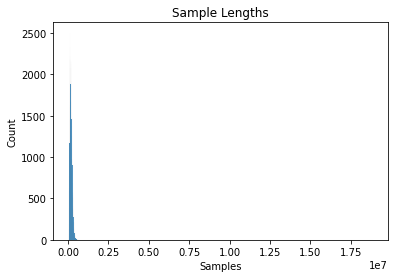

In [13]:
sns.histplot(lengths)
plt.title('Sample Lengths')
plt.xlabel('Samples')
plt.show()

In [14]:
np.max(lengths)/np.mean(lengths)

96.7253495006746

This is a very bottom heavy distribution, and the maximum length is nearly 100x the mean.

Note that the longest file is much longer than even the 100th longest file.

## Loading Spectrograms

This code is primarily used to convert audio to mel spectrograms, but some of it is used to load mel spectrograms from the disk. Do not worry if you are not familiar with mel spectrograms. They are discussed in detail below.

In [15]:
def load_signal(audio_file_id, sr=SAMPLE_RATE):
    '''
    Loads the signal from a WAV file
    '''
    audio_dir_prefix = 'cv-valid-'
    
    audio_file_location = audio_dir_prefix+audio_file_id+'.wav'
    signal, sr = librosa.load(audio_file_location, sr=sr)
    
    return signal

def padding(signal, mean_voice_len, train_set):
    '''
    Pads samples from test set. Pads or truncates test/val data
    '''
    signal_output = np.zeros((mean_voice_len,))
    if train_set:
        signal_len = np.min([mean_voice_len, len(signal)])
        signal_output[:signal_len] = signal[:signal_len]
    else: # May have to truncate test/val set, not just pad
        signal_len = np.min([mean_voice_len, len(signal)])
        signal_output[:signal_len] = signal[:signal_len]
    return signal_output
    
def compute_spectrogram(signal, sr=SAMPLE_RATE):
    '''
    Computes the Mel Spectrograam from an audio signal
    '''
    ms = librosa.feature.melspectrogram(y=signal, sr=sr)
    log_spec = librosa.power_to_db(ms, ref=np.max)
    
    return log_spec

def normalize_spectrogram(spectrogram):
    '''
    Normalizes the spectrogram to have values between zero and one
    '''
    normed_spectrogram = (spectrogram - np.min(spectrogram)) / (np.max(spectrogram) - np.min(spectrogram))
    
    return normed_spectrogram


def save_spectrogram(audio_file_id, output_file_location, train_set):
    '''
    Computes and saves the mel spectrogram for a single audio file.
    '''    
    # Compute and normalize spectrograms
    signal = load_signal(audio_file_id)
    signal = padding(signal, mean_voice_len=mean_voice_len, train_set=train_set)
    spectrogram = compute_spectrogram(signal)
    spectrogram = normalize_spectrogram(spectrogram)
        
    # save spectrogram
    with open(output_file_location, 'wb') as f:
        pickle.dump(spectrogram, f)
    return None

def save_spectrograms(audio_file_ids, train_set, mean_voice_len):
    '''
    Computes mel spectrograms from WAV files, normalizes them and saves them to the disk
    '''
    spectrogram_base_dir = 'mel-spectra/'
    audio_dir_prefix = 'cv-valid-'
    
    print('Computing spectrograms from audio signals and saving to disk') 
    spectrograms = []
    
    for id in tqdm(audio_file_ids):
        # Save spectrograms to the disk
        output_file_location = spectrogram_base_dir+id+'.pkl'

        ms = save_spectrogram(id, output_file_location, train_set)
        spectrograms.append(ms)
        
    return np.asarray(spectrograms)

def load_spectrogram(audio_file_id):
    '''
    Loads a spectrogram from a pickle file given its id
    '''
    spectrogram_base_dir = 'mel-spectra/'
    spectrogram_file_location = spectrogram_base_dir+audio_file_id+'.pkl'

    with open(spectrogram_file_location, 'rb') as f:
        ms = pickle.load(f)
            
    return ms

def load_spectrograms(audio_file_ids):
    '''
    Loads mel spectrograms from pickle files
    '''
    for id in tqdm(audio_file_ids):
        ms = load_spectrogram(id)

    return None

def process_split(split_ids, train_set=True, mean_voice_len=None):
    '''
    Loads spectrograms if present on the disk, otherwise computes and saves them.
    '''
    split = split_ids[0].split('/')[0]
    spectrogram_dir = os.listdir('mel-spectra/'+split)
    
    # Check if the data has been processed
    if len(spectrogram_dir) < len(split_ids):
        save_spectrogram(split_ids, train_set, mean_voice_len)
    else:
        print('Data is on the disk and will be loaded at train time.')

x_train = process_split(train_ids, train_set=True, mean_voice_len=mean_voice_len)
x_test = process_split(test_ids, train_set=False, mean_voice_len=mean_voice_len)
x_val = process_split(val_ids, train_set=False, mean_voice_len=mean_voice_len)

Data is on the disk and will be loaded at train time.
Data is on the disk and will be loaded at train time.
Data is on the disk and will be loaded at train time.


# Dropping Silent Audio
Through the normalization process above, I found that one of the tracks was entirely silent, thus trying to scale its magnitudes to between 0 and 1 threw a divide by zero warning. I drop this track from the dataset.

In [16]:
sig = load_signal(train_ids[22692])
Audio(sig, rate=48000)

c:\Users\Patrick\AppData\Local\Programs\Python\Python39\lib\site-packages\IPython\lib\display.py:174: RuntimeWarning: invalid value encountered in true_divide
  scaled = data / normalization_factor * 32767


As you can hear, the audio is totally silent. We can see that too.

The amplitude of every sample is zero, showing quantitatively that it is silent. Since the track is silent, I will drop it from the dataset. First, I check for other NaN values.

In [17]:
# Check spectrograms for NaNs
nan_ids = []
nan_idxs = []
for i, id in enumerate(tqdm(train_ids)):
    spectrogram = load_spectrogram(id)
    if np.isnan(spectrogram).any():
        print(f'{id} contains NaNs')
        nan_ids.append(id)
        nan_idxs.append(i)

 31%|███       | 22934/74059 [00:16<00:36, 1419.36it/s]

train/sample-060119 contains NaNs


 44%|████▍     | 32560/74059 [00:23<00:28, 1471.78it/s]

train/sample-085463 contains NaNs


100%|██████████| 74059/74059 [00:51<00:00, 1424.31it/s]


Note the first file is the one I already identified. I take a look at the second filer below.

Like the other audio track, every sample in this track has an amplitude of zero, so it is totally silent. I delete both tracks.

In [21]:
train_ids = np.delete(train_ids, obj=nan_idxs)
df = df.loc[~df['id'].isin(nan_ids)]

# What is a Mel Spectrogram

At the level of actual model development, things will look identical to building a classifier for images. This is misleading. In order to eliminate the black box nature of the pipeline, I provide a detailed but optional explanation of mel spectrograms, which my model takes as inputs.

As stated above, a mel spectrogram shows how the frequencies present in an audio signal change as the audio signal changes with time with both the frequency and the magnitude of the frequency presented in a perceptually relevant way. In order to understand this, it is easiest to build up to the concept. I begin from the concept of sound as a wave the build to Fourier Transforms, Short Time Fourier Transforms and Mel Spectrograms. Feel free to skip any of these.

## Sound as Waves and Fourier Transforms

To begin with, it is first important to understand that sound is composed of waves. Specifically, sound is perturbations in matter, in our usual case, the air. In "real life" and analog recordings, these waaves are continuous. Computers cannot handle continuous values. So digital audio signals are created by "sampling" chunks of a continuous signal at a rate determined by the sample rate. It is still convention to refer to the resulting signal as a wave. I refer to samples and time interchangably, but note that the number of samples that have passed is a proxy for time.

We can thus think of sound as a waveform and plot it as such. Here, I use as an example a midi sample of a guitar playing A.

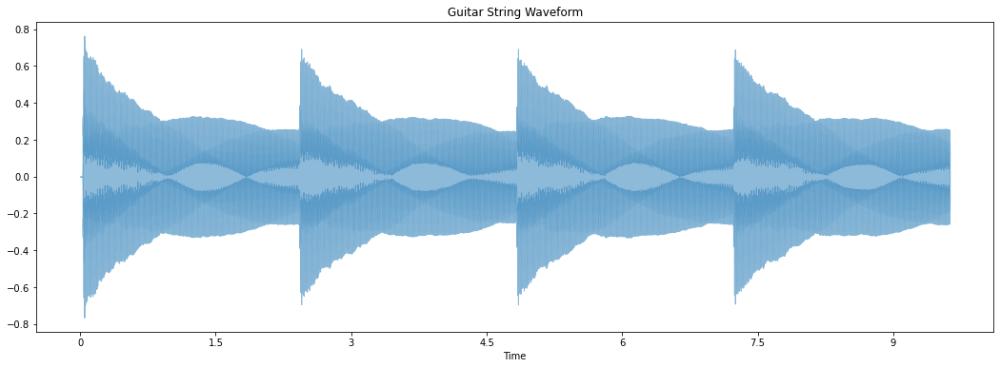

In [22]:
plt.figure(figsize=(18,6))
ex_song = "Guitar A4.wav"
guitar, sr = librosa.load(ex_song, sr=None)
librosa.display.waveshow(y=guitar, sr=sr, x_axis='time', alpha=0.5)
plt.title('Guitar String Waveform')
Audio(guitar, rate=sr)

Above we can see very clearly where the string has been plucked and that the height of the wave then decreases before the string is struck again. But zooming in, we can see greater detail.

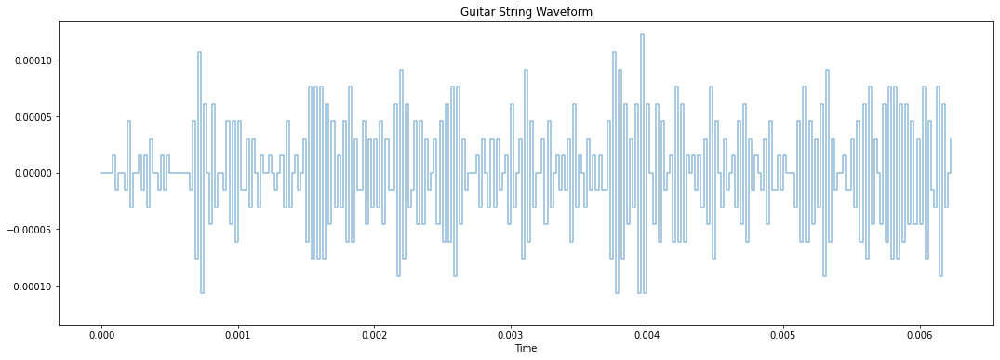

In [23]:
plt.figure(figsize=(18,6))
librosa.display.waveshow(y=guitar[:300], sr=sr, x_axis='time', alpha=0.5)
plt.title('Guitar String Waveform')
plt.show()

We can see here that the waveform is actually changing very rapidly in time. When we analyze the wave form, we say we are looking at the signal in the "time domain."

While this audio signal has been quantized, an analog signal would be more smooth, and it would be a bit - but not much - easier to see that we can actually see that an audio signal can be thought of as a sum of sinusoidal waves. A sine wave has an amplitude, the height of the wave, and a frequency, the relative distance between successive peaks (and a phase which can be ignored for our purposes). A complex sound like a guitar string being struck is composed of maany sinusoidal waves with various frequencies (and phases). Another way to analyze sound would be to look at the relative presence of various frequencies.

Fourier transforms let us do just that: let us analyze the presences of frequencies in sound. The Fourier transform for the guitar string is shown below.

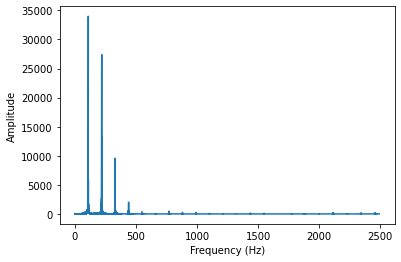

In [24]:
guitar_ft = fft(guitar)
magnitude_spectrum = np.abs(guitar_ft) # The real components give frequency information. We discard phase information.

max_idx = len(magnitude_spectrum[:sr//2]) # The discrete Fourier transform mirrors around the sample rate/2, so we discard frequencies over sr/2
frequencies = np.linspace(0, sr//2, num = max_idx) 
frequencies = fftfreq(len(guitar), d=1/sr)
sns.lineplot(x=frequencies[:max_idx], y=magnitude_spectrum[:max_idx])
plt.xlabel('Frequency (Hz)')
plt.ylabel('Amplitude')
plt.show()

Thhe x-axis of this graph shows frequencies which are measured in hertz. The y-axis is shows the amplitude of a frequency. Later, we will work with the more familiar decibel units, but for now, we can think of amplitude as telling us about the strength of a frequency in an audio signal. When we work with Fourier transforms, we say we are working in the "frequency domain."

We can see a number of spikes on the graph. We can think of these spikes as showing the strength of the corresponding frequency in the sound. Specifically, the first and largest spike is called the fundamental frequency. We will confirm below that this is 110Hz, the frequency to which the lowest A string on a six string guitar is tuned. Integer multiples of this frequency are called harmonics. The combination of harmonics and other frequencies are what give guitars their unique sound.

In [25]:
fundamental_freq = frequencies[np.argmax(magnitude_spectrum)]
print(f'The fundamental frequency is {fundamental_freq}Hz.')

The fundamental frequency is 109.59829109773597Hz.


This is just about exactly what we expect.

Clearly we have learned something important about our guitar sound clip: what frequencies are the most important to the sound. But we have lost any information about time. In fact, we can make the bold claim that the frequency domain plot above looks remarkably similar to the plot of a string being plucked only one time. Strictly speaking, there is an inverse Fourier transformation. But that just takes us back to the time domain where we lose interpretable information about the frequencies in our signal. What we would like is a way to see how the presence of frequencies in our audio signal change over time. This motivates the Short Time Fourier Transformation.

## Short Time Fourier Transformation

The short time fourier transformation is a very intuitive extension to the Fourier transformation. The short time Fourier transform fundamentally consists of breaking an audio signal into chunks and performing a Fourier transform on each. 

Recall that to make a digital audio signal, a continuous signal is broken into samples, each of which has an amplitude. To perform the short time fourier transform, the signal is broken into frames. Each frame will consist of a certain number of samples with a corresponding amplitude. On each frame, a Fourier transformation is performed. The result is what we call a "spectrogram," and it tells us how frequency information about the sound changes over time.

When looking at spectrograms we have time on our x-axis and frequency on our y-axis. We will also begin showing the strength of frequencies in terms of decibels (power or energy over time) rather than amplitude. Decibels are related to amplitude logarithmically. This has a couple of obvious benefits. First, it makes it easier for us to interpret the spectrogram. But second, and perhaps more crucially, we perceive sound logarithmically. So if we want our machine learning models to learn about the intensity of sound the way we perceive it, there is a reason to believe we should show the strength of frequencies in decibels, not as amplitudes.


*A fully optional side note*: the experienced reader may note a lack of and the curious reader may be interested in a discussion of windowing functions. This is unnecessary for understanding the information in a spectrogram. Issues arise if there is a discontinuity between the beginning and ending of a frame, a problem known as [spectral leakage](https://en.wikipedia.org/wiki/Spectral_leakage). This discontinuity is removed using a window function. But the window function causes the signal to decay towards the boundaries of frames. To fight this second problem, frames are made to overlap. This is crucial to computing spectrograms, but does not change that spectrograms show how frequencies present in an audio signal change over time.

The spectrogram for our audio signal is show below.

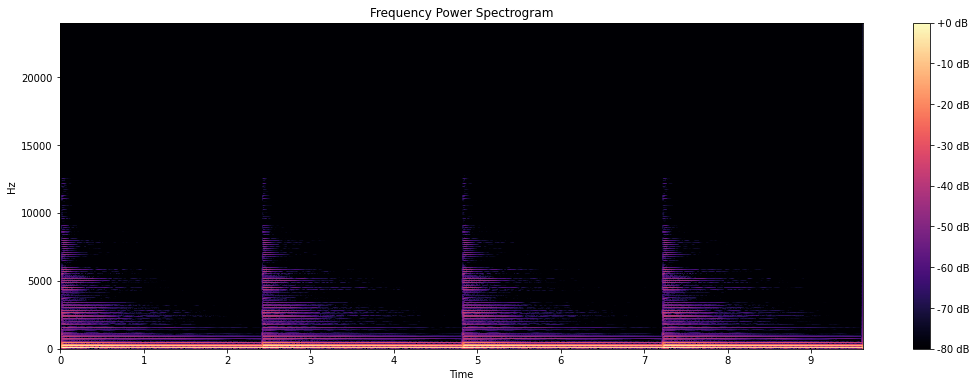

In [26]:
hop_length = 512
window_length = 2048

stft = np.abs(librosa.stft(guitar))
s_db = librosa.amplitude_to_db(stft, ref=np.max)

plt.figure(figsize=(18,6))
img = librosa.display.specshow(s_db, y_axis='linear', x_axis='time', sr=sr)
plt.title('Frequency Power Spectrogram')
plt.colorbar(img, format='%+2.0f dB')
plt.show()

Note that we recover our four string strikes.

Up until this point, we have a feature that allows us to show how the frequencies in a piece of audio change with the magnitude of the frequency presented in a way that reflects how we hear loudness. But what about pitch? For that, we finally need Mel spectrograms.

## Mel Spectrograms
The mel spectrogram is named after the mel scale. Hertz is a poor unit to represent how we hear sounds. Humans are much better at distinguishing between sounds at lower frequencies than at higher frequencies. This is because we hear pitch logarithmically. The mel scale is thus a logarithmic scale in which numerical distance is meant to reflect perceptual distance. While two frequencies 200 Hz apart may be two octaves or two notes apart depending where they are located on the frequency scale, two frequencies 200 mels apart should always sound like they are separated by the same interval.

Creating the mel spectrogram consists of creating the magnitude spectrogram, then applying mel filterbanks to the magnitude spectrogram. We already know how to do the first part, but the second is quite involved.

To create the mel filter banks, first you need to pick a number of mel bands. This is a hyperparameter and depends on the problem you are solving. You then convert the minimum and maximum frequencies in your magnitude spectrogram into mels. Between these points, you select equally spaced points until you have a number of points equivalent to your desired number of bands. These will be the center of your mel filter bands.

Next, convert those points back to Hz and round them to the nearest bin in your magnitude spectrum. Now they are spaced logarithmically, not equally. From each center, you draw a triangle with the size of the base increasing with the center frequency of the mel band and which overlaps with adjacent bands. The resulting filters are your mel filter bank. The increasing spacing and increasing overlap between filters represents our increasing inability to distinguish between pitches at increasingly higher frequencies. 

So far this is all a bit much. The standard way to teach this would be to now show the filter banks. But the mel filter bank is just a matrix, and applying it simply consists of multiplying it with your magnitude spectrum from the left.

I show an example filter bank and its application below. I chose 10 mel bands because it helps distinct bands show up nicely on the plots. In practice, you would want substantially more.

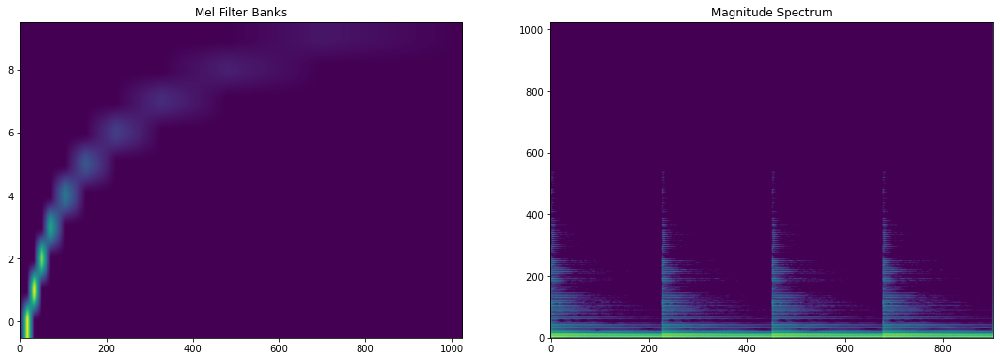

In [27]:
example_mels = 10 # This makes each band easy to see
ms = librosa.feature.melspectrogram(y=guitar, sr=sr, n_fft=2048, n_mels=example_mels)
ms = librosa.power_to_db(ms, ref=np.max)


fig, axes = plt.subplots(1,2,figsize=(18,6))
mel_filter_bank = librosa.filters.mel(sr=sr, n_fft=2048, n_mels=example_mels)
axes[0].imshow(mel_filter_bank, aspect='auto')
axes[0].invert_yaxis()
axes[0].set_title('Mel Filter Banks')

axes[1].imshow(s_db, aspect='auto')
axes[1].invert_yaxis()
axes[1].set_title('Magnitude Spectrum')

plt.show()

On the left plot, we have the mel filter banks. The y-axis is in mels and the x-axis is in Hz. We can see a few key features. First, as the mels increase, the filters become wider. Second, the filters overlap, and that overlap also increases with mels. Third, they are equally spaced as mels increase but logarithmically increase with frequency.

On the right, we have the familiary magnitude spectrogram for the guitar. We will multiply these matrices together. The result will give us a matrix that shows how the loudness of each band changes in time.

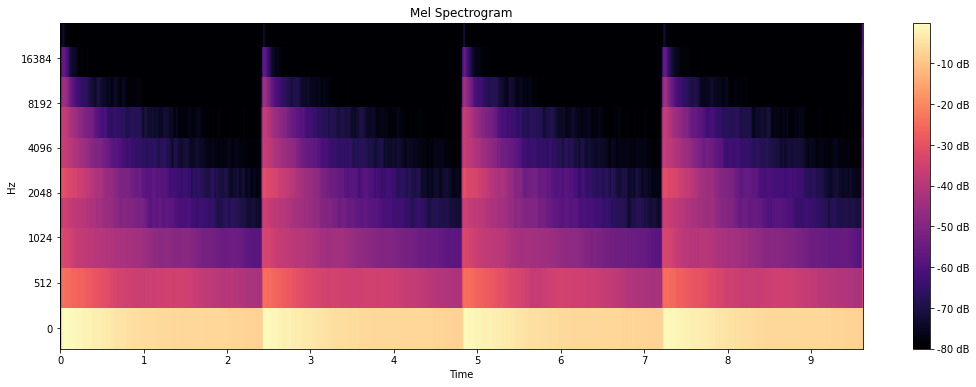

In [28]:
plt.figure(figsize=(18,6))
img = librosa.display.specshow(ms, y_axis='mel', x_axis='time', sr=sr)
plt.title('Mel Spectrogram')
plt.colorbar(img, format='%+2.0f dB')
plt.show()

It is important to note what we are seeing here. On the magnitude spectrogram, we can get meaning out of any distinct point in time-frequency space. This spectrogram is different. We have 10 distinct bands (because we chose to have 10 bands) centered on 10 distinct frequencies. We see not how the decibels in each frequency change over time but how the decibels in each band change over time.

This is the mel spectrogram. It is a feature that shows how an audio signal changes time with both pitch and loudness represented in a way that reflects how human beings perceive sound.

It is worth noting that the mel spectrograms are not the only choice for deep learning. Rather, and not overlooking the fact that model performance is the ultimate goal, mel spectrograms reflect assumptions about what we want the model to learn, reflected in how mel spectrograms represent audio in a perceptually relevant way. If we wanted to enforce fewer assumptions, we could use something like the magnitude spectrum above. If we wanted to enforce more assumptions about what the model should learn, we would use [mel frequency ceptral coefficients](https://en.wikipedia.org/wiki/Mel-frequency_cepstrum), which, if properly engineered, allow us to separate out information most relevant to speech-based tasks. Even waveforms can be used as inputs to deep learning models.

# Visualizing Audio
I plot the waveform for an example clip of a man, woman, and an "other" sample.

In [29]:
def plot_audio(audio_id):
    spec = load_spectrogram(audio_id)
    sig = load_signal(audio_id)

    fig, axes = plt.subplots(1, 2, figsize=(18, 6))
    librosa.display.waveshow(y=sig, sr=SAMPLE_RATE, alpha=0.5, ax=axes[0])
    img = librosa.display.specshow(data=spec, sr=SAMPLE_RATE, x_axis='time', y_axis='linear', ax=axes[1])
    fig.colorbar(img, format='%+2.0f dB')
    plt.show()    
    
ex_phrase = 'it was the pure language of the world' # Has audio for all three gender values


In [31]:
female_ex = df.loc[(df['gender']=='female') & (df['text']==ex_phrase)].iloc[0]['id']
male_ex = df.loc[(df['gender']=='male') & (df['text']==ex_phrase)].iloc[0]['id']
other_ex = df.loc[(df['gender']=='other') & (df['text']==ex_phrase)].iloc[0]['id']

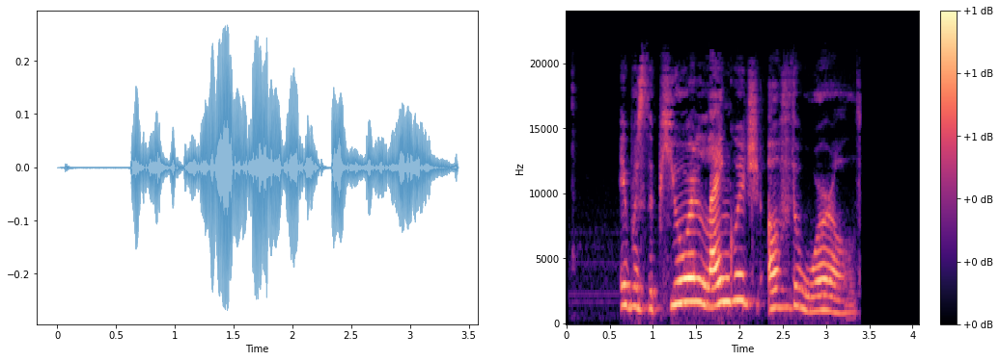

In [32]:
female_audio =  load_signal(female_ex)
plot_audio(female_ex)
Audio(female_audio, rate=SAMPLE_RATE)


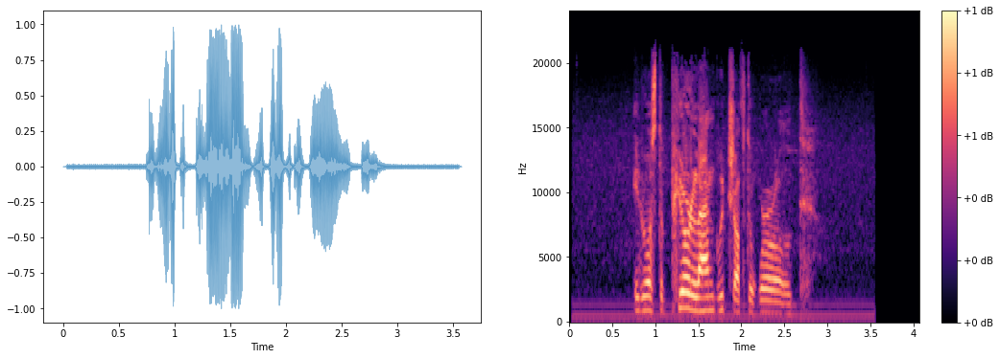

In [33]:
male_audio =  load_signal(male_ex)
plot_audio(male_ex)
Audio(male_audio, rate=SAMPLE_RATE)

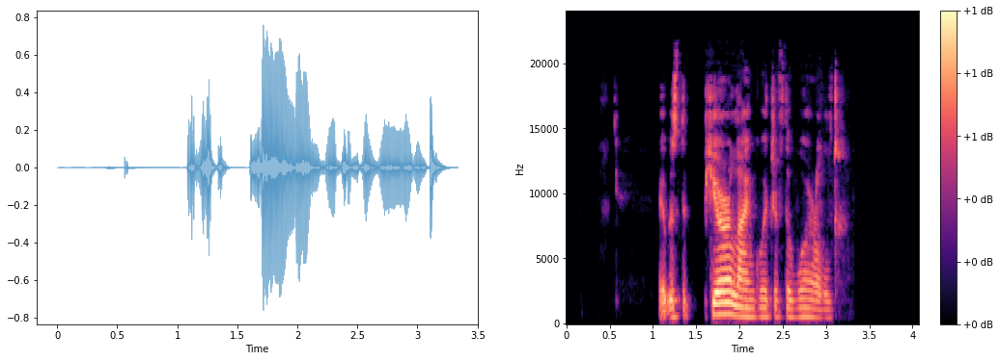

In [34]:
other_audio =  load_signal(other_ex)
plot_audio(other_ex)
Audio(other_audio, rate=SAMPLE_RATE)

Other than areas in which speakers get quiet, which are easy to spot as either low amplitude or dark spots on the waveforms and spectrograms respectively, it is hard to pick out differences in the classes visually. This is no doubt in part because there are not just variations in speech between genders but also within genders. Fortunately, a deep learning model can sort out these differences.

# Gender Balance

I check the data to see how each class is represented.

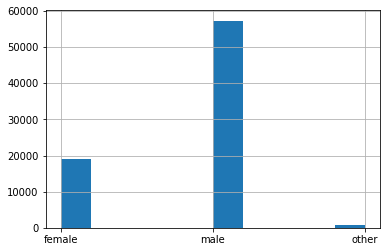

In [36]:
df['gender'].hist()
plt.show()

We can see here that male samples are much more common than female samples, and both are much more common than "other" samples. In this case, this affects model performance. The general reasoning is that imbalanced data leads to the model "guessing" the majority class when it is unsure. This leads to a net decrease in loss but poor performance on minority classes. This would obviously be an issue for a class as small as the "other" class, but in this case, I had a problem with "female" samples, too. To address the latter, I bootstrap the dataset, discussed below.

It is worth taking a moment to recognize this as a non-trivial issue. Gender is self-reported in the dataset, so the "other" category does not simply represent unlabeled samples. Perhaps more data should be collected in this category.

## Oversample Female Voices
To improve the recall on the female class, I oversample it randomly with replacement, i.e. I bootstrap the data. This does cause a gap between train and test performance to increase, but this is minimized using dropout as regularization, and it substantially improves performance on women's voices. I do not oversample the "other" category, as I did not find that to provide a significant increase in performance. This issue of gender imbalance is probably best solved in the data collection stage. The dataset used is multipurpose, so it is understandable that the genders are imbalanced. But for a gender detection model I planned to deploy in production, I would want the training data to be balanced in the same way as the target userbase.

In [37]:
num_male = len(df.loc[(df['set']=='train') & (df['gender']=='male')])

# Good values: 0.3
oversample_frac = 0.2

In [38]:
df_list = [df]

for class_label, class_data in df.loc[df['set']=='train'].groupby('gender'):
    if class_label == 'female':
        num_oversample = int((num_male-len(class_data))*oversample_frac)
        oversample_df = class_data.sample(n=num_oversample, replace=True)
        df_list.append(oversample_df)
        print(class_label, num_male-len(class_data))
    
df = pd.concat(df_list)

female 36778


We then have to get the unique identifiers for the data again, specifically the training set data.

In [39]:
train_ids = df.loc[df['set']=='train']['id'].values

val_ids = df.loc[df['set']=='dev']['id'].values

test_ids = df.loc[df['set']=='test']['id'].values

print(f'There are {len(train_ids)} train ids')
print(f'There are {len(test_ids)} test ids')
print(f'There are {len(val_ids)} validation ids')

There are 81412 train ids
There are 1541 test ids
There are 1540 validation ids


# Load Data

In [40]:
y_train = pd.get_dummies(df.loc[df['set']=='train'][target_feature]).values
y_val = pd.get_dummies(df.loc[df['set']=='dev'][target_feature]).values
y_test = pd.get_dummies(df.loc[df['set']=='test'][target_feature]).values

In [41]:
def data_gen(audio_ids, classes, batch_size):
    while 1:
        start_idx = 0
        num_samples = len(audio_ids)
        for i in range(0, num_samples, batch_size):
            # Get a batch of ids
            end_idx = start_idx + batch_size
            if end_idx >= num_samples:
                batch = audio_ids[start_idx:]
                targets = classes[start_idx:]
            else:
                batch = audio_ids[start_idx:end_idx]
                targets = classes[start_idx:end_idx]
            start_idx += batch_size
            
            # Load spectrograms
            audio_features = [np.expand_dims(load_spectrogram(id), axis=[0,-1]) for id in batch]
            audio_features = np.vstack(audio_features)
            
            
            yield audio_features, targets

In [42]:
batch_size = 16 # Good values: 32, 16
train_gen = data_gen(train_ids, y_train, batch_size)
val_gen = data_gen(val_ids, y_val, 1)
test_gen = data_gen(test_ids, y_test, 1)


Next, I get the size of the spectrograms, which will be needed to build the model.

In [75]:
spec = load_spectrogram(train_ids[0])
n_mels = spec.shape[0]
max_len = spec.shape[1]

# Model

We can treat the data like an image with one channel. More specifically, we can use convolutional layers, like we would with images. In the image context, the convolution operation reflects our assumption that the value of a pixel is not independent of the pixels around it. In the spectrogram context, a point in the spectrogram does is not a pixel with a spectral location. It is a magnitude (loudness) with a time-frequency location. The points in the area above/below it are those with higher frequencies. We expect those pixels to be related. For example, if I sing the note A4 at 440hz, we expect the magnitude to peak at 440Hz but to also be much higher around 440Hz than at, say, 20,000Hz. Similarly, the points to the left and right of our point of choice are points earlier and later in time respectively. If I sing A4 loudest at time T, we expect the magnitudes locally aat 440Hz to the left and right to be substantially higher than before I began singing. In short, the convolution operation makes sense for analyzing spectrograms, just as it does for analyzing images.

The reader who is familiar with using deep learning for computer vision will note that we would use an architecture and loss like those below, for example, to classify black and white images.

Note that while training, I track accuracy as a "sanity check," but due to the imbalanced nature of the problem, this metric fails to properly capture model performance (i.e. for sufficiently imbalanced data, the model can improve accuracy by guessing the majority class when unsure).

In [58]:
def build_model(n_mels, max_len, n_target_classes, filters, dropout_rate):
    inputs = Input(shape=(n_mels, max_len, 1))
    x = Conv2D(filters, kernel_size=(3,3), activation='relu', padding='same')(inputs)
    x = Conv2D(filters, kernel_size=(3,3), padding='same')(x)
    x = BatchNormalization()(x)
    x = Activation('relu')(x)
    x = MaxPool2D()(x)
    
    x = Flatten()(x)
    x = Dropout(dropout_rate)(x)
    outputs = Dense(n_target_classes, activation='softmax')(x)
    
    model = Model(inputs, outputs)
    return model

In [45]:
model = build_model(n_mels, max_len, 3, 32, 0.3)
model.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 128, 382, 1)]     0         
                                                                 
 conv2d (Conv2D)             (None, 128, 382, 32)      320       
                                                                 
 conv2d_1 (Conv2D)           (None, 128, 382, 32)      9248      
                                                                 
 batch_normalization (BatchN  (None, 128, 382, 32)     128       
 ormalization)                                                   
                                                                 
 activation (Activation)     (None, 128, 382, 32)      0         
                                                                 
 max_pooling2d (MaxPooling2D  (None, 64, 191, 32)      0         
 )                                                           

In [46]:

train_steps = len(train_ids)//batch_size
val_steps = len(val_ids)
es = EarlyStopping(monitor='val_loss', verbose=1, min_delta=0.01, patience=5, restore_best_weights=True)


model.compile(optimizer=Adam(1e-5), loss='categorical_crossentropy', metrics='accuracy')
history = model.fit(train_gen, steps_per_epoch=train_steps, validation_data=val_gen, validation_steps=val_steps, epochs=200, callbacks=es)

Epoch 1/200
5088/5088 [==============================] - 111s 21ms/step - loss: 0.2291 - accuracy: 0.9251 - val_loss: 4.3378 - val_accuracy: 0.2623
Epoch 2/200
5088/5088 [==============================] - 103s 20ms/step - loss: 0.1664 - accuracy: 0.9478 - val_loss: 3.8540 - val_accuracy: 0.2812
Epoch 3/200
5088/5088 [==============================] - 104s 20ms/step - loss: 0.1329 - accuracy: 0.9580 - val_loss: 3.8688 - val_accuracy: 0.2929
Epoch 4/200
5088/5088 [==============================] - 97s 19ms/step - loss: 0.1082 - accuracy: 0.9661 - val_loss: 2.9981 - val_accuracy: 0.3500
Epoch 5/200
5088/5088 [==============================] - 96s 19ms/step - loss: 0.0884 - accuracy: 0.9723 - val_loss: 2.8630 - val_accuracy: 0.3786
Epoch 6/200
5088/5088 [==============================] - 96s 19ms/step - loss: 0.0731 - accuracy: 0.9772 - val_loss: 2.8733 - val_accuracy: 0.4026
Epoch 7/200
5088/5088 [==============================] - 96s 19ms/step - loss: 0.0592 - accuracy: 0.9826 - val_loss

I save the model to the disk.

In [47]:
ckpt_dir = 'ckpt_oversample/'
model.save_weights(ckpt_dir)

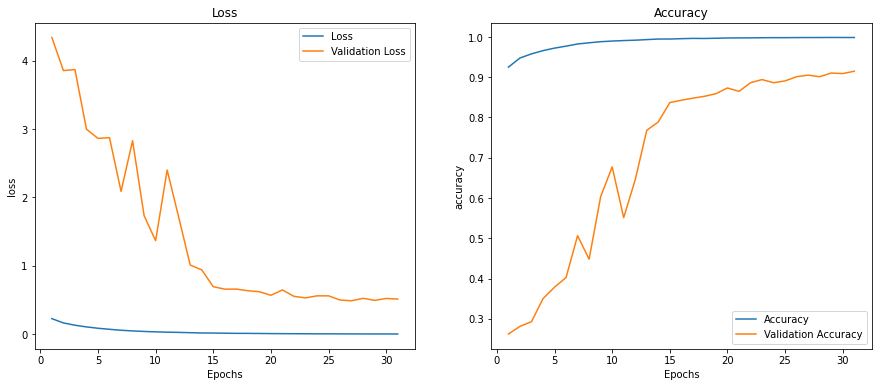

In [84]:
fig, axes = plt.subplots(1, 2, figsize=(15, 6))
epochs = range(1, len(history.history['loss'])+1)
sns.lineplot(history.history, x=epochs, y='loss', label='Loss', ax=axes[0])
sns.lineplot(history.history, x=epochs, y='val_loss', label='Validation Loss', ax=axes[0])
axes[0].set_title('Loss')
axes[0].set_xlabel('Epochs')



sns.lineplot(history.history, x=epochs, y='accuracy', label='Accuracy', ax=axes[1])
sns.lineplot(history.history, x=epochs, y='val_accuracy', label='Validation Accuracy', ax=axes[1])
axes[1].set_title('Accuracy')
axes[1].set_xlabel('Epochs')
plt.show()

# Evaluate model

I evaluate the model using a confusion matrix, precision, and recall.

In [50]:
y_pred = model.predict(test_gen, steps=len(test_ids))

1541/1541 [==============================] - 2s 1ms/step


In [66]:
labels = ['Female', 'Male', 'Other']

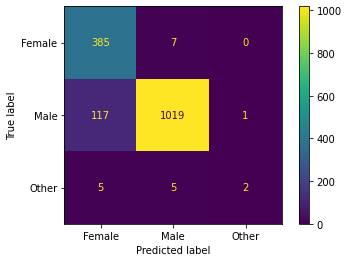

In [71]:
disp = ConfusionMatrixDisplay(confusion_matrix(np.argmax(y_test, axis=1), np.argmax(y_pred, axis=1)),
                              display_labels=labels)
disp.plot()
plt.show()

Below are the classification results for the model, followed by results for a model trained without oversampling. Performance is defined using precision, recall and f1-score. These are defined as followed, each with respect to a class. I use the abbreviations TP and FP for true and false positives and the abbreviations TN and FN for true negatives and false negatives.

**Precision** is the portion of samples predicted to belong to a class that actually belong to that class.

$Precision = \frac{TP}{TP+FP}$

**Recall** is the portion of samples that actually belong to a class, which were correctly identified as belonging to that class.

$Recall = \frac{TP}{TP+FN}$

Also presented are the f1-score and accuracy.

The **F1-score** is the (harmonic) mean of precision and recal

$\text{F1-Score} = 2\frac{precision * recall}{precision+recall}$

In [69]:
print(classification_report(np.argmax(y_test, axis=1), np.argmax(y_pred, axis=1), target_names=labels, zero_division=0))

              precision    recall  f1-score   support

      Female       0.76      0.98      0.86       392
        Male       0.99      0.90      0.94      1137
       Other       0.67      0.17      0.27        12

    accuracy                           0.91      1541
   macro avg       0.80      0.68      0.69      1541
weighted avg       0.93      0.91      0.91      1541



### Results without Oversampling
We can compare this to a model trained without oversampling.

In [70]:
# Load model trained on data without oversampling
no_bootstrap_model = build_model(n_mels, max_len, 3, 64, 0.3)
no_bootstrap_model.load_weights('ckpt_no_oversample/')

test_gen = data_gen(test_ids, y_test, 1)
y_pred_no_bootstrap = no_bootstrap_model.predict(test_gen, steps=len(test_ids))
print(classification_report(np.argmax(y_test, axis=1), np.argmax(y_pred_no_bootstrap, axis=1), target_names=labels, zero_division=0))

              precision    recall  f1-score   support

      Female       0.91      0.80      0.85       392
        Male       0.93      0.97      0.95      1137
       Other       0.00      0.00      0.00        12

    accuracy                           0.92      1541
   macro avg       0.61      0.59      0.60      1541
weighted avg       0.91      0.92      0.92      1541



There is a tradeoff here. The model I choose has excellent recaall on women's voices, and good recall on men's voices. The other model has excellent recall on men's voices but its recall on women's voices is worse than the selected model's recall on men's voices. Oversampling women's voices did also increase performance on the "other" class, albeit not to any high level.

This is not a pure improvement, however; the selected model's improved recall on women's voices comes with decreased precision. In other words, oversampling the data makes the model correctly classify more women's voices as women's voices, but it does so by incorrectly classifying more non-women's voices as womens voices.

For the purposes of a gender classifier, where the goal is to correctly classify as many people's voices according to the correct gender, the increase in recall is a sufficient basis to choose the model trained on oversampled data.

# Example Classifier

Below I write a function using the model above to classify some sample audio.

In [55]:
def classify_voie(audio_file_loc, sr, mean_len=mean_voice_len):
    '''
    Classifies audio by gender given some audio file and sample rate.
    '''
    classes = ['Female', 'Male', 'Other']
    
    voice, _ = librosa.load(audio_file_loc, sr=sr)
    voice = voice[:mean_len]
    
    spectrogram = compute_spectrogram(voice, sr=sr)
    spectrogram = normalize_spectrogram(spectrogram)
    
    spectrogram = spectrogram[np.newaxis,:,:,np.newaxis]
    
    preds = model.predict(spectrogram, verbose=0)
    
    pred_class_idx = np.argmax(preds)
    
    pred_class = classes[pred_class_idx]
    
    return pred_class

ex_dir = 'misc-audio/'
ex_names = ['patrick.wav', 'caitlin reilly.wav', 'linda.wav']

for name in ex_names:
    pretty_name = name.split('.')[0]
    print(f'Prediction and probabilities for {pretty_name}')
    print(classify_voie(ex_dir + name, sr=44000))

Prediction and probabilities for patrick
Male
Prediction and probabilities for caitlin reilly
Female
Prediction and probabilities for linda
Female


# Analyze Classifications

In [56]:
df_test = df.loc[df['set']=='test']

In [57]:
def classify_voice_from_id(audio_file_id, sr, mean_len=mean_voice_len):
    classes = ['female', 'male', 'other']
    
    voice = load_signal(audio_file_id)
    
    voice = padding(voice, mean_voice_len=mean_voice_len, train_set=False)

    spectrogram = compute_spectrogram(voice, sr=sr)
    spectrogram = normalize_spectrogram(spectrogram)
    
    spectrogram = spectrogram[np.newaxis,:,:,np.newaxis]
    
    preds = model.predict(spectrogram, verbose=0)
    
    pred_class_idx = np.argmax(preds)
    
    pred_class = classes[pred_class_idx]
    
    return pred_class

test_preds = [classify_voice_from_id(id, sr=SAMPLE_RATE) for id in tqdm(test_ids)]

100%|██████████| 1541/1541 [01:12<00:00, 21.16it/s]
